In [1]:
import pandas as pd
import numpy as np
import sklearn as sk
from matplotlib import pyplot as plt
import matplotlib
import matplotlib.cm as mplcm
import matplotlib.colors as colors
import re
from scipy.signal import savgol_filter
from math import ceil, floor
from sklearn.linear_model import LogisticRegression
from pathlib import Path
from scipy.optimize import curve_fit
from scipy.optimize import differential_evolution
import warnings
from statsmodels.stats.proportion import proportion_confint
import requests, json, time
# from pymuller import muller

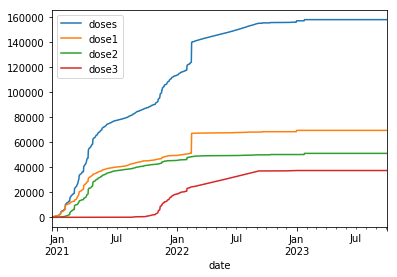

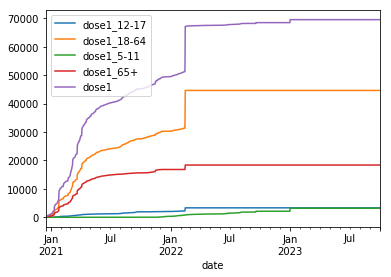

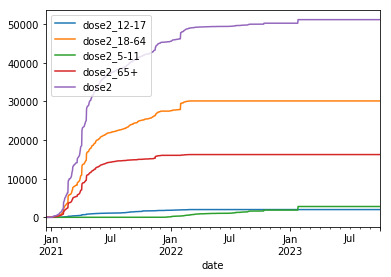

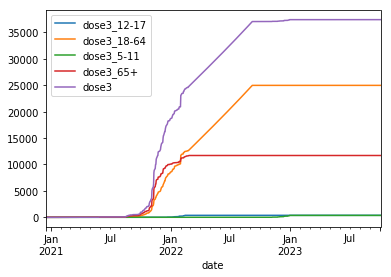

In [22]:
fips = "51045"

data = pd.read_csv("/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/products/external_data_collection/age_data/VDH_age_vaccinations_per_100K_scenario_high_boost_OptVax.csv", parse_dates = ["date"], dtype = {"fips":str}).set_index(["fips", "date"])

data.loc[fips][["doses", "dose1", "dose2", "dose3"]].plot()
data.loc[fips][[c for c in data.columns if "dose1" in c]].plot()
data.loc[fips][[c for c in data.columns if "dose2" in c]].plot()
data.loc[fips][[c for c in data.columns if "dose3" in c]].plot()

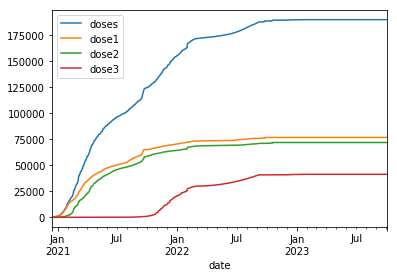

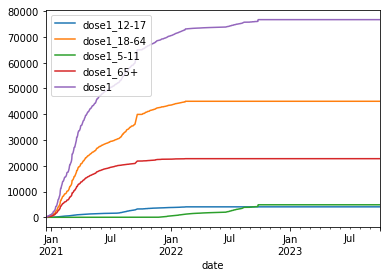

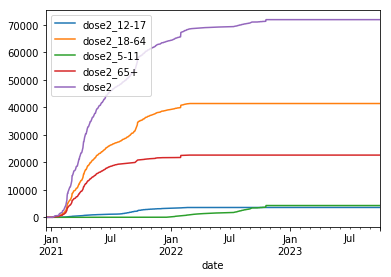

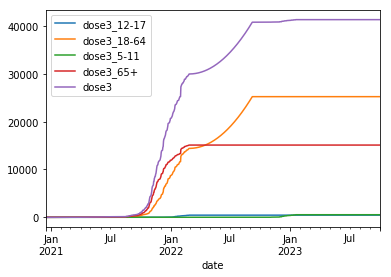

In [16]:
data = pd.read_csv("/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/products/external_data_collection/age_data/VDH_age_vaccinations_per_100K_scenario_high_boost_OptVax.csv", parse_dates = ["date"], dtype = {"fips":str}).set_index(["fips", "date"])

data.loc["51001"][["doses", "dose1", "dose2", "dose3"]].plot()
data.loc["51001"][[c for c in data.columns if "dose1" in c]].plot()
data.loc["51001"][[c for c in data.columns if "dose2" in c]].plot()
data.loc["51001"][[c for c in data.columns if "dose3" in c]].plot()

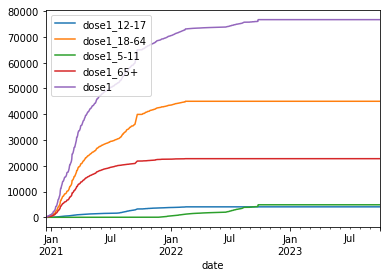

In [ ]:
state_to_stfips_path ="/project/biocomplexity/COVID-19_commons/2019-nCoV_stat-analyses/misc_data/stfips_to_state.csv"
state_to_stfips_df = pd.read_csv(state_to_stfips_path, header=None, dtype={"2":str})
state_to_stfips_df[2] = state_to_stfips_df[2].astype(str).str.zfill(2)
state_to_stfips = state_to_stfips_df.set_index(0)[2].to_dict()
state_to_stfips = state_to_stfips_df.set_index(0)[2].to_dict()
state_to_state_abbr = state_to_stfips_df.set_index(0)[1].to_dict()
stfips_to_state_abbr = state_to_stfips_df.set_index(2)[1].to_dict()
abbr_to_stfips = state_to_stfips_df.set_index(1)[2].to_dict()

plot_path = Path("/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new")

def convert_state_stfips(state):
    try:
        return state_to_stfips[state]
    except:
        return np.nan
    
def convert_abbr_stfips(abbr):
    try:
        return abbr_to_stfips[abbr]
    except:
        return np.nan
        
def convert_accession_epi(accession):
    try:
        return accession_to_epi[accession]
    except:
        return np.nan
    
metadata = pd.read_csv("../variant_data/metadata.tsv", sep="\t", parse_dates = ["Collection date", "Submission date"])

def get_nth_slash(row, n):
    try:
        return row.split("/")[n].strip()
    except:
        return np.nan
    
for i in range(4):
    metadata[f"Location_{i}"] = metadata["Location"].apply(lambda row: get_nth_slash(row, i))
    
metadata = metadata.rename(columns={"Location_1":"country", "Location_2":"state"})
metadata = metadata[metadata["country"] == "USA"]
metadata["alias"] = metadata["Virus name"].apply(lambda row: "/".join(row.split("/")[2:]))


In [3]:
metadata = metadata[["Collection date", "Pango lineage", "state", "Submission date"]]
metadata.columns = ["date", "variant", "state", "submission_date"]
metadata.date = pd.to_datetime(metadata.date)
metadata.state = metadata.state.apply(convert_state_stfips)
metadata = metadata.dropna()

In [3]:
def get_state_variants(state, data_orig, rolling=False, normalize=True):
    
    data = data_orig.copy().loc[state]
    samples = data.sum(axis=1)
        
    if rolling:
        data = data.rolling(7).mean()
    else:  
        data = data.apply(lambda col: savgol_filter(col, 31, 1), axis=0)
        
    data = data.where(data > 0, other=0)
    data.other = data.other.replace(0, 0.001)
    if normalize:
        data = data.divide(data.sum(axis=1), axis=0)
#     for column in set(variant_names) - set(data.columns):
#         data[column] = 0
    data["samples"] = samples
    data["days"] = data.index
    data.days = (data.days - data.index.min()).dt.days
    
    if state in ["US", "USA"]:
        data = data[data.samples > 200]
    
    return data

def train_state_prevalence_model(data):
    
    variants = len(data.columns) - 2
    long_data = data.melt(id_vars=["days", "samples"])
    long_data.samples = long_data.samples * 100 #So small numbers are still considered
    long_data.samples = long_data.samples * long_data.value
    long_data.samples = long_data.samples.apply(lambda row: floor(row)).replace(0, np.nan)
    long_data = long_data.dropna().sort_values("days").drop(columns=["value"]).rename(columns={"variable":"variant"})
    
    if variants > 1:
        model = LogisticRegression(multi_class="multinomial", solver="lbfgs", max_iter=5000, random_state=42)
    else:
        model = LogisticRegression(solver="lbfgs", max_iter=5000, random_state=42)
        
    model.fit(long_data.days.to_numpy().reshape(-1,1), long_data.variant, sample_weight=long_data.samples)
        
    return model

def predict_variants(state, data_orig, start_at, num_days_out=60, rolling=False, variants = []):
    
    data = get_state_variants(state, data_orig, rolling=rolling)
    if variants:
        variants += ["samples", "days"]
        non_var_cols = [c for c in data.columns if c not in variants]
        data["other"] = data[non_var_cols].sum(axis=1)
        data = data[variants + ["other"]]
    data = data.loc[start_at:]
    data.days = data.apply(lambda row: (row.index - data.index.min()).days)["days"]

    variant_names = [c for c in data.columns if c not in ["samples", "days"]]
#     data = data[set(data.columns)]
    model = train_state_prevalence_model(data)
    num_days = (data.index.max() - data.index.min()).days + num_days_out
    
    x_pred = np.array(range(0, num_days)).reshape(-1,1)
    preds = model.predict_proba(x_pred)
    preds = pd.DataFrame(preds, columns=model.classes_)
    preds.index = pd.Series(preds.index).apply(lambda row: data.index.min() + np.timedelta64(row, "D"))
    for column in set(variant_names) - set(preds.columns):
        preds[column] = 0
    preds = preds[variant_names]
        
    return preds, data[["samples"]]

def plot_variant_predictions(state, ax, data_orig, num_days_out=60, stackplot=True, rolling=False, start_at = None):
    
    if start_at is None:
        start_at = pd.to_datetime("now") - np.timedelta64(5, "M")
    
    plot_names = data_orig.columns
    variants, samples = predict_variants(state, data_orig, start_at, num_days_out=num_days_out, rolling=rolling)

    last_gt = (variants.index.max() - np.timedelta64(num_days_out, "D"))
    past_variants = variants.loc[:last_gt]
    future_variants = variants.loc[last_gt + np.timedelta64(1, "D"):]
    if stackplot:
#         ax.set_prop_cycle(color=terrain_variant_colors)
        ax.set_prop_cycle(color=get_color_map("terrain", past_variants.shape[1]))
#         ax.stackplot(variants.index, variants.T, labels=variants.columns)
        ax.stackplot(past_variants.index, past_variants.T, labels=past_variants.columns)
#         ax.set_prop_cycle(color=terrain_variant_colors)
        ax.set_prop_cycle(color=get_color_map("terrain", past_variants.shape[1]))
    
        ax.stackplot(future_variants.index, future_variants.T, labels=[], alpha=0.5)
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc="upper left")
        lines = handles
    else:
#         ax.set_prop_cycle(color=tab_variant_colors)
        ax.set_prop_cycle(color=get_color_map("tab20b", past_variants.shape[1]))
        lines = ax.plot(past_variants.index, past_variants, linewidth=4)
#         ax.set_prop_cycle(color=tab_variant_colors)
        ax.set_prop_cycle(color=get_color_map("tab20b", past_variants.shape[1]))
        
        ax.plot(future_variants.index, future_variants, linewidth=4)
        ax.legend(lines[::-1], past_variants.columns[::-1], loc="upper left")
    
    ax.axvline(variants.index.max() - np.timedelta64(num_days_out, "D"), color="k", linestyle="--", linewidth=2)
    ax.set_ylim(0,1)
    ax.set_xlim(variants.index.min(), variants.index.max())
#     try:
#         above_5 = variants["B.1.617.2"]
#         above_5 = above_5[above_5 >= 0.05].index.min()
#     except:
#         above_5 = variants["B.1.617"]
#         above_5 = above_5[above_5 >= 0.05].index.min()
    above_5 = "" #str(above_5).split()[0]
    return lines, past_variants.columns, samples, above_5, variants

def plot_state_variants(state, ax, data_orig, rolling=False, normalize=True, stackplot=True, start_at="2021-01-01", variant_names = None):
    
    if variant_names is not None:
        variant_names = list(variant_names)
        data = data[variant_names] #.abs()
        
    else:
        data = data_orig.copy()
        variant_names = data.columns

    data = get_state_variants(state, data, rolling=rolling, normalize=normalize)
    data = data.loc[start_at:]
    data = data.drop(columns=["samples", "days"])
        
    if stackplot:
        ax.set_prop_cycle(color=get_color_map("tab20", data.shape[1]))
        ax.stackplot(data.index, data.T, labels=data.columns)
    else:
        ax.set_prop_cycle(color=get_color_map("tab20", data.shape[1]))
        data.plot(ax=ax, linewidth=4)
    
    ax.legend(loc="upper left")   
    
    ax.set_ylim(0,1)
    ax.set_xlim(data.index.min(), data.index.max())

def get_color_map(name, number):
    cm = plt.get_cmap(name)
    cNorm  = colors.Normalize(vmin=0, vmax=number)
    scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)
    tab_variant_colors = [scalarMap.to_rgba(i) for i in range(number)]
    return tab_variant_colors


In [6]:
combine_lineages = False
combined_str = "_with_sub_lineages_combined" if combine_lineages else ""

variants = pd.concat([metadata], ignore_index=True)
variants.date = pd.to_datetime(variants.date)
variants.submission_date = pd.to_datetime(variants.submission_date.apply(lambda row: str(row).split()[0]))

variants = variants[variants.date >= "2020-02-27"] #First day with >10 samples

all_variants = variants.copy()

all_variants.variant = all_variants.variant.apply(lambda row: "other" if "BA" not in row and row != "B.1.1.529" else row)

variants.variant = variants.variant.apply(lambda row: re.sub("AY\.3.*", "AY.3", row))
variants.variant = variants.variant.apply(lambda row: re.sub("AY\.4.*", "AY.4", row))
variants.variant = variants.variant.apply(lambda row: re.sub("AY\.[1256789].*", "AY.other", row))

vocs = ['B.1.1.7',
        'B.1.1.529',
        "BA.1",
        "BA.2",
        "BA.1.1",
        'B.1.351',
        'P.1',
        'B.1.617.1',
        'B.1.617.2',
        'AY.3',
        'AY.4',
        'AY.other']

variants.variant = variants.variant.apply(lambda row: row if row in vocs else "other")
#May need to edit the below to properly handle the AY substrains of B.1.617.2 (it may need to be its own "class" here) 
if combine_lineages: 
    variants.variant = variants.variant.apply(lambda row: re.sub("42[79]", "42X", re.sub("\.[12]$", "", re.sub("AY.*", "B.1.617", (re.sub("BA.*", "B.1.1.529", row))))).replace("P", "P.1"))
# variants.variant.unique()
# print(variants.variant.unique())

variants.to_csv(f"/project/biocomplexity/COVID-19_commons/data/variants/variant_samples_by_state{combined_str}.csv", index=False)

variant_prevalences = variants.groupby(["date", "variant", "state"]).count().reset_index()
date_state_samples = variant_prevalences.groupby(["date", "state"]).submission_date.sum().to_dict()
variant_prevalences["submission_date"] = variant_prevalences.apply(lambda row: row.submission_date / date_state_samples[(row.date, row.state)], axis=1) # (variant_prevalences[(variant_prevalences.date == row.date) & (variant_prevalences.state == row.state)].submission_date.sum()), axis=1)
variant_prevalences.rename(columns={"submission_date":"prevalence_proportion"}).to_csv(f"/project/biocomplexity/COVID-19_commons/data/variants/variant_prevalences_by_state{combined_str}.csv", index=False)

to_plot_names = sorted(['B.1.1.7',
        'B.1.1.529',
        'BA.1',
        'BA.2',
        'BA.1.1',
        'B.1.351',
        'P.1',
        'B.1.617.1',
        'B.1.617.2',
        'AY.3',
        'AY.4',
        'AY.other',
        'B.1.427',
        'B.1.429',
        'B.1.526',
        'C.37', 
        'B.1.621']) #,
#         'B.1.526.1',
#         'B.1.526.2'])

if combine_lineages:
    to_plot_names = sorted(['B.1.1.7',
        'B.1.1.529',
        'P.1',
        'B.1.617',
        'B.1.621'])

variant_names = variants.variant.unique()
NUM_COLORS = len(to_plot_names) + 1

cm = plt.get_cmap('terrain')
cNorm  = colors.Normalize(vmin=0, vmax=NUM_COLORS)
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)
terrain_variant_colors = [scalarMap.to_rgba(i) for i in range(NUM_COLORS)]

cm = plt.get_cmap('tab20b')
cNorm  = colors.Normalize(vmin=0, vmax=NUM_COLORS)
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)
tab_variant_colors = [scalarMap.to_rgba(i) for i in range(NUM_COLORS)]

vocs = [v for v in vocs if v in variant_names]
to_plot_names = [v for v in to_plot_names if v in variant_names]


In [4]:
def apply_rules(name, rules):
    for orig, replacement in rules.items():
        name = re.sub(orig, replacement, name)
        
    return name

def aggregate_with_rules(rules, names):
    data = variants.copy()
    data.columns = [apply_rules(c, rules) for c in data.columns]
    data = data.groupby(data.columns, axis=1).sum()
    data["other"] = data[[c for c in data.columns if c not in names or c == "other"]].sum(axis=1)
    data = data.drop(columns = [c for c in data.columns if c not in names and c != "other"])
    names_in_col = [c for c in names if c in data.columns]
    names_not_found = [c for c in names if c not in data.columns]
    if names_not_found:
        print(f"Did not find variants {','.join(names_not_found)} in the base data")
    data = data[names_in_col + ["other"]]
    
    return data

In [5]:
"""Variant Focus Params"""
focus_name = "Omicron"
focus_rules = dict() # Applied before filtering of names below
focus_names = ["BA.1", "BA.1.1", "BA.2", "B.1.1.529"]

"""Combined Lineages Params"""
combined_rules = {"AY.*":"B.1.617", "42[79]":"42X", "\.[12]$":"", "BA.*":"B.1.1.529", "P":"P.1"}
combined_names = ['B.1.1.529', 'B.1.1.7', 'B.1.617', 'B.1.621', 'P.1']

"""All Lineages Params"""
all_rules = {"AY\.3.*":"AY.3", "AY\.4.*":"AY.4", "AY\.[1256789].*":"AY.other"}
all_names = ["BA.1", "BA.1.1", "BA.2", "B.1.1.529", 'AY.3', 'AY.4', 'AY.other', 'B.1.1.7', 'B.1.351', \
             'B.1.427', 'B.1.429', 'B.1.526', 'B.1.617.1', 'B.1.617.2', 'B.1.621', 'C.37', 'P.1']


In [6]:
combine_lineages = False
combined_str = "_with_sub_lineages_combined" if combine_lineages else ""

path = "/project/biocomplexity/COVID-19_commons/data/variants/outbreak_info_variants_states_long.csv"
variants = pd.read_csv(path, dtype={"fips":str}, parse_dates=["date"])
other_count = variants.pivot(index=["date","fips"], columns = "lineage", values="total_count")
variants = variants.pivot(index=["fips","date"], columns = "lineage", values="lineage_count").fillna(0).sort_index()
variants["other"] = other_count.max(axis=1) - variants.sum(axis=1)

focused_variants = aggregate_with_rules(focus_rules, focus_names)
combined_variants = aggregate_with_rules(combined_rules, combined_names)
all_variants = aggregate_with_rules(all_rules, all_names)

named_data = {focus_name:focused_variants, "Combined":combined_variants, "All":all_variants}
prediction_start = None

Did not find variants B.1.1.529 in the base data
Did not find variants B.1.1.529 in the base data


In [7]:
def get_us_grid():
    stat_notes = "/project/biocomplexity/COVID-19_commons/2019-nCoV_stat-analyses/notebooks/"
    state_hhs = pd.read_csv(stat_notes+'../misc_data/state_hhs_map.csv',usecols=[0,1,2,3],names=['sFIPS','HHS','state','StateName'],dtype=str)
    state_hhs['HHS'] = state_hhs.HHS.apply(lambda x: 'HHS Region {}'.format(x))
    us_df = pd.read_csv(stat_notes+'../misc_data/us_subplot_grid.csv')
    
    return us_df

def plot_gt(stackplot, rolling, data, name):
    
    rolling_str = "rolling" if rolling else "savgol"
    stackplot_str = "stackplot" if stackplot else "lines"
    stackplot_str = rolling_str + "_" + stackplot_str

    us_df = get_us_grid()
    fig = plt.figure(figsize=(54,36)) 
    gs = fig.add_gridspec(8,12)
    
    if name in ["Combined", "All"]:
        start_at = "2021-01-01"
    else:
        start_at = pd.to_datetime("now") - np.timedelta64(5, "M")

    us_ax = fig.add_subplot(gs[0:2, 7:9])
    plot_state_variants("US", us_ax, data, stackplot=stackplot, rolling=rolling, start_at=start_at)
    us_ax.set_title("United States", fontsize=30)
    us_ax.set_ylabel("Prevalence", fontsize=24)
    us_ax.set_ylim(0,1.05)
    us_ax.get_legend().remove()

    for r in range(8):
        for c in range(12):
            mask = (us_df.Row==r)&(us_df.Column==c)

            if len(us_df[mask])==0: # and not unseen_regions:
                pass
            else:
                ax = fig.add_subplot(gs[r,c])
                state = us_df[mask]['Name'].values[0]
                fips = state_to_stfips[state]
                try:
                    plot_state_variants(fips, ax, data, stackplot=stackplot, rolling=rolling, start_at=start_at)
                except:
                    ax.set_visible(False)
                    continue
                ax.set_title(state, fontsize=30)
                ax.set_ylabel("Prevalence", fontsize=24)
                ax.set_ylim(0,1.05)
                h1, l1 = ax.get_legend_handles_labels()
                ax.get_legend().remove()

    fig.autofmt_xdate()
    fig.legend(h1[::-1], l1[::-1], bbox_to_anchor=(0.45, 1), fontsize=32)
    plt.tight_layout()
#     plt.savefig(f"output/voc_prevalence_proportions_ground_truth_{stackplot_str}{combine_str}.png", dpi=100, bbox_inches="tight", facecolor="white")
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/voc_prevalence_proportions_ground_truth_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")
    
    fig, ax = plt.subplots(figsize=(10,8))
    plot_state_variants("51", ax, data, stackplot=stackplot, rolling=rolling, start_at=start_at)
    ax.set_title("Virginia", fontsize=30)
    ax.set_ylabel("Prevalence", fontsize=24)
    ax.set_ylim(0,1.05)
    ax.legend(loc="upper left")
    fig.autofmt_xdate()
    plt.tight_layout()
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/VA_only_voc_prevalence_proportions_ground_truth_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")
    
    fig, ax = plt.subplots(figsize=(10,8))
    plot_state_variants("US", ax, data, stackplot=stackplot, rolling=rolling, start_at=start_at)
    ax.set_title("United States", fontsize=30)
    ax.set_ylabel("Prevalence", fontsize=24)
    ax.set_ylim(0,1.05)
    ax.legend(loc="upper left")
    fig.autofmt_xdate()
    plt.tight_layout()
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/US_only_voc_prevalence_proportions_ground_truth_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")
    

def plot_predictions(stackplot, data, name):
    state_preds = []
    dates = []
    stackplot_str = "stackplot" if stackplot else "lines"
    
    us_df = get_us_grid()
    fig = plt.figure(figsize=(54,36)) 
    gs = fig.add_gridspec(8,12)

    us_ax = fig.add_subplot(gs[0:2, 7:9])
    plot_variant_predictions("US", us_ax, data, stackplot=stackplot, start_at=prediction_start)
    us_ax.set_title("United States", fontsize=32)
    us_ax.set_ylabel("Prevalence", fontsize=24)
    us_ax.get_legend().remove()

    for r in range(8):
        for c in range(12):
            mask = (us_df.Row==r)&(us_df.Column==c)

            if len(us_df[mask])==0: # and not unseen_regions:
                pass
            else:
                ax = fig.add_subplot(gs[r,c])
                state = us_df[mask]['Name'].values[0]
                fips = state_to_stfips[state]
                try:
                    h1, l1, samples, above_5_date_6172, variants = plot_variant_predictions(fips, ax, data, stackplot=stackplot, start_at=prediction_start)
                    dates.append((fips, above_5_date_6172))
                    state_preds.append((state, variants))
                except:
                    ax.set_visible(False)
                    continue
                ax.set_title(f"{state}", fontsize=30)
                ax.set_ylabel("Prevalence", fontsize=24)
                ax.get_legend().remove()
                
    fig.autofmt_xdate()
    fig.legend(h1[::-1], l1[::-1], bbox_to_anchor=(0.45, 1), fontsize=32)
    plt.tight_layout()
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/voc_prevalence_proportions_predictions_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")
    
    fig, ax = plt.subplots(figsize=(10,8))
    h1, l1, _, above_5_date_6172, _ = plot_variant_predictions("51", ax, data, stackplot=stackplot, start_at=prediction_start)
    ax.set_title(f"Virginia", fontsize=30)
    ax.set_ylabel("Prevalence", fontsize=24)
    ax.legend(h1, l1, loc="upper left")
    fig.autofmt_xdate()
    plt.tight_layout()
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/VA_only_voc_prevalence_proportions_predictions_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")
    
    fig, ax = plt.subplots(figsize=(10,8))
    h1, l1, _, _, _ = plot_variant_predictions("US", ax, data, stackplot=stackplot, start_at=prediction_start)
    ax.set_title(f"United States", fontsize=30)
    ax.set_ylabel("Prevalence", fontsize=24)
    ax.legend(h1, l1, loc="upper left")
    fig.autofmt_xdate()
    plt.tight_layout()
    plt.savefig(f"/sfs/qumulo/qproject/biocomplexity/COVID-19_commons/data/variants/plots/new/US_only_voc_prevalence_proportions_predictions_{stackplot_str}_{name}.png", dpi=100, bbox_inches="tight", facecolor="white")

    return state_preds
        

On Omicron
On Combined


<ipython-input-9-9909f6ef4735>:68: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(10,8))


On All


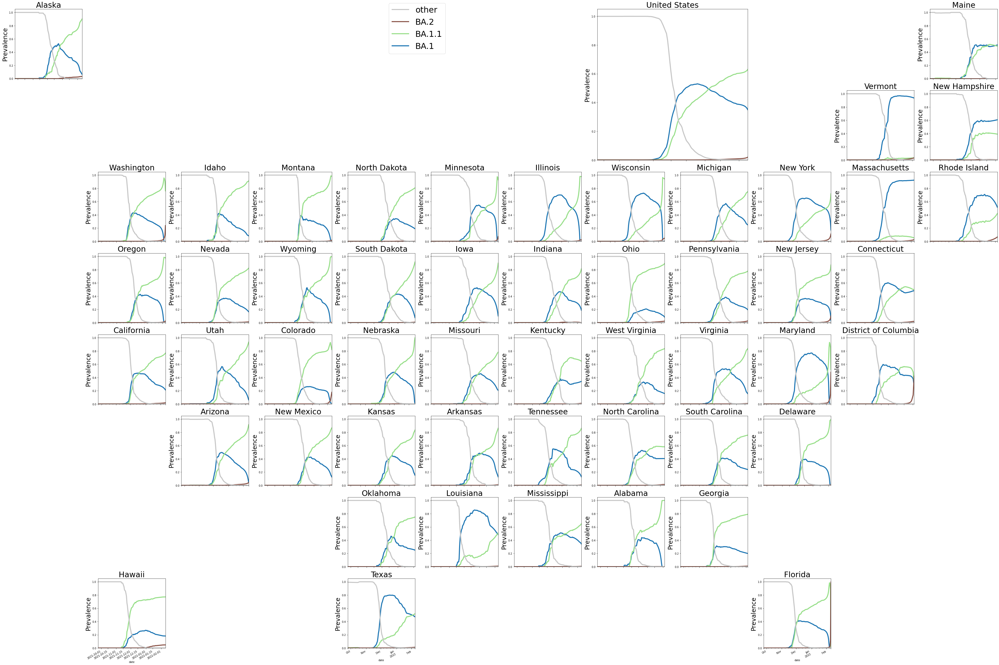

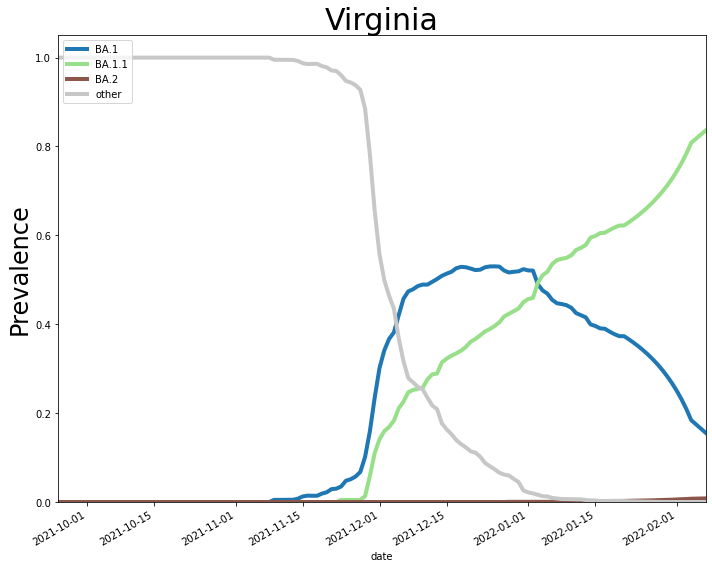

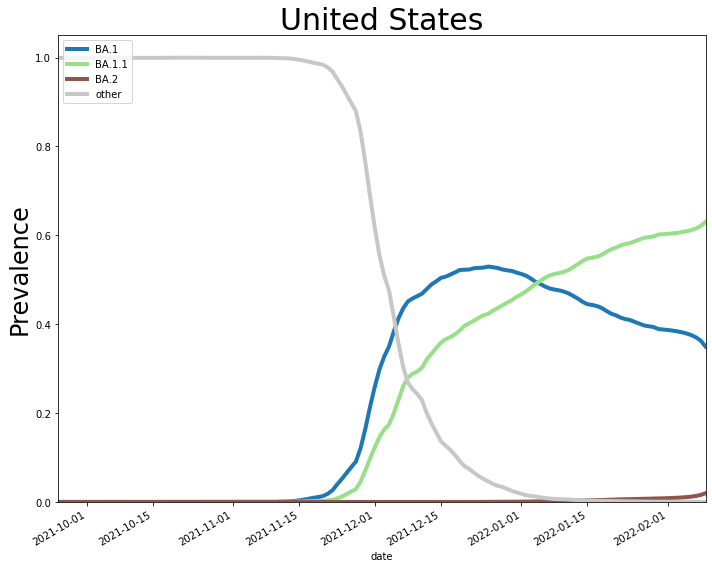

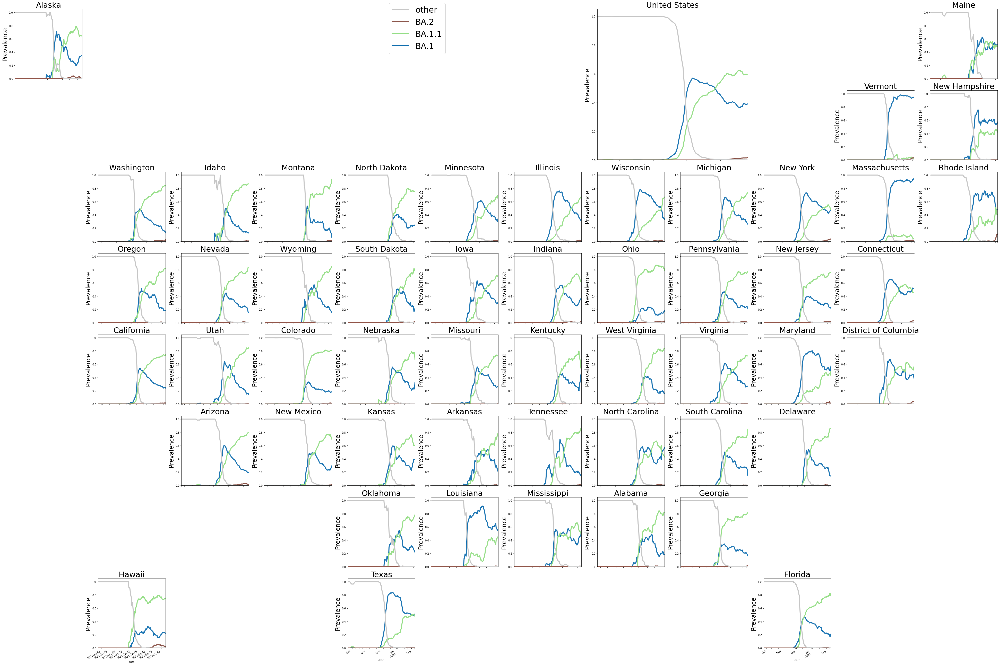

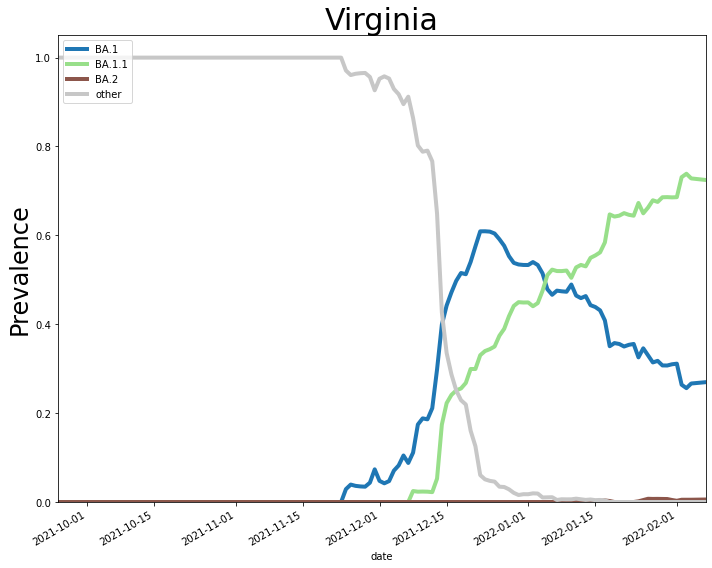

...

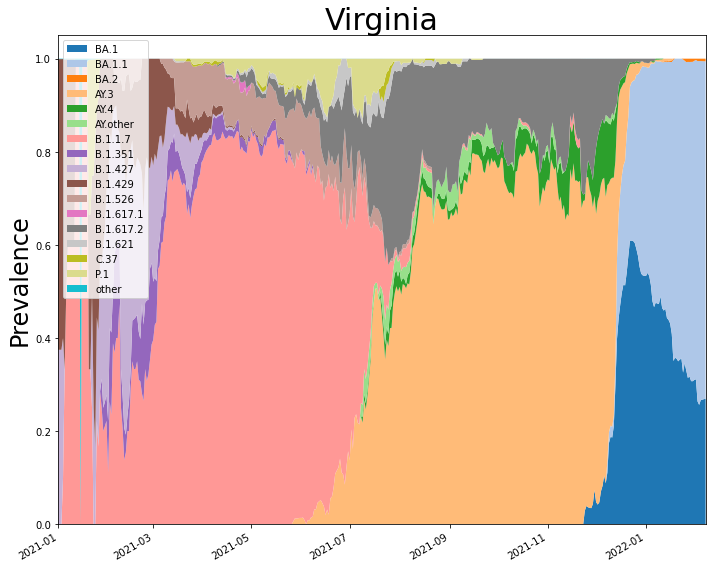

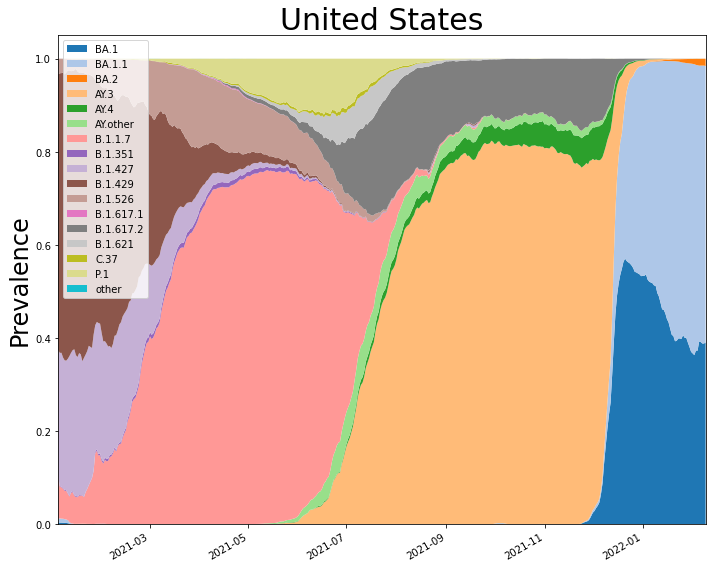

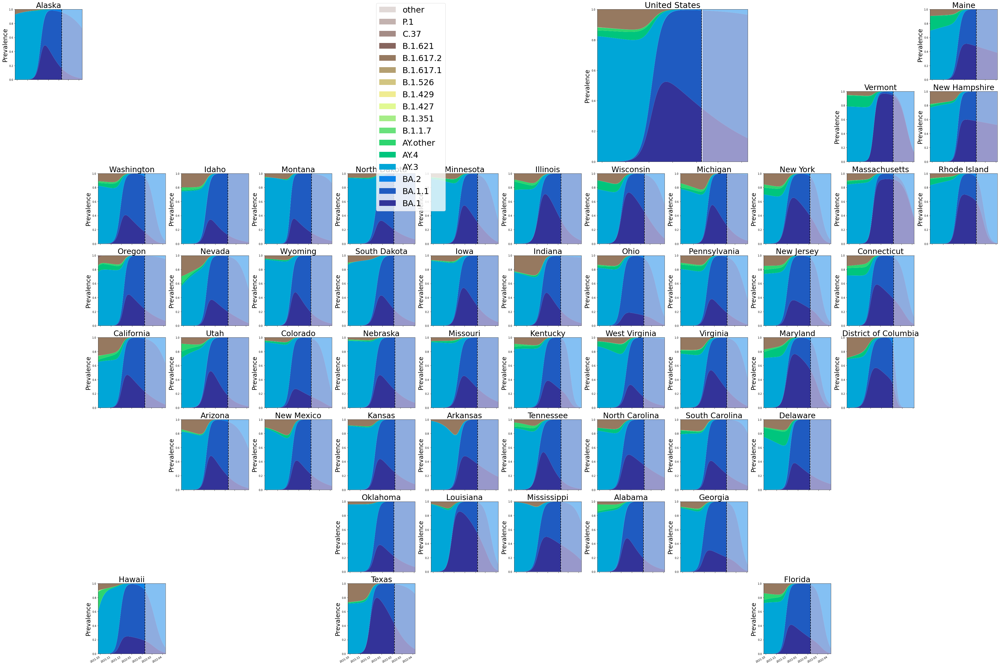

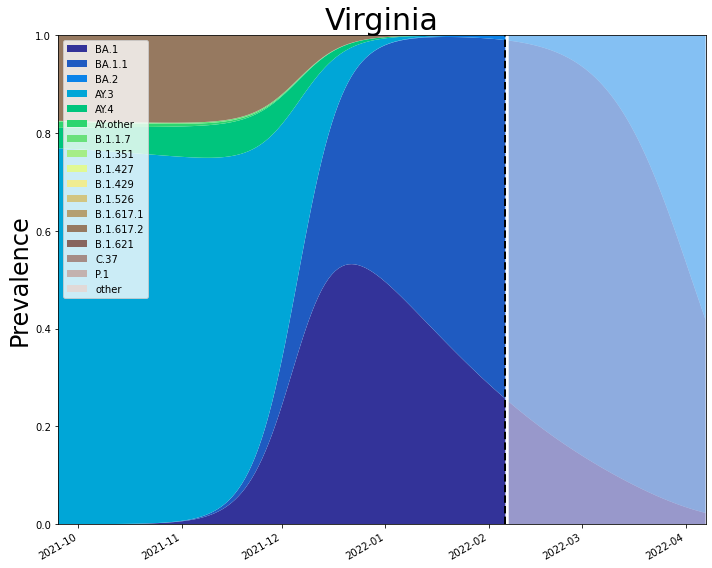

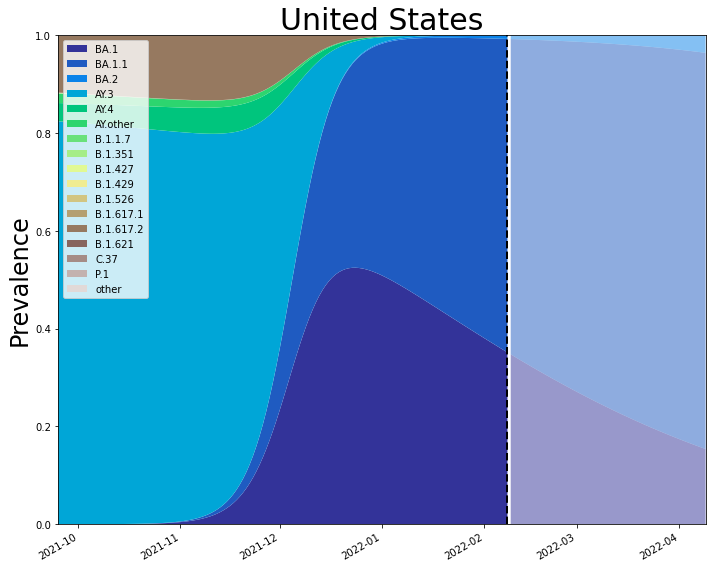

In [10]:
for name, data in named_data.items():
    print("On", name)
    for stack in range(2):
        for roll in range(2):
            plot_gt(stack, roll, data, name)
            
        state_preds = plot_predictions(stack, data, name)        